# 13_BANKSY_style_SIMBA_coembedding.ipynb

In [1]:
%load_ext autoreload
%autoreload 2


import sys
sys.path.insert(1, '../scripts/benchmarking')

In [2]:
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
from src.plot import plot_spatial, palette_celltype, plot_obs_spatial
import pandas as pd
import numpy as np
palette_entity_anno = palette_celltype.copy()
palette_entity_anno['gene'] = "lightgray"
from mpl_toolkits.axes_grid1 import make_axes_locatable
import anndata as ad
from scipy.sparse import csr_matrix

import os
import simba as si
si.__version__

workdir = 'data/13'
si.settings.set_workdir(workdir)

si.settings.set_figure_params(
    dpi=80,
    style='white',
    fig_size=[5,5],
    rc={'image.cmap': 'viridis'}
)

from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats('retina')

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Saving results in: data/13


# SIMBA-BANKSY local

In [3]:
local_adata_C = sc.read_h5ad(f"data/12/local_adata_C.h5ad")
local_adata_G = sc.read_h5ad(f"data/12/local_adata_G.h5ad")

In [4]:
local_adata_G.obs['gene_type'] = ['gene_mean' if '_mean' in g else 'gene' for g in local_adata_G.obs.index]
local_adata_G.obs['original_gene'] = [g.split("_mean")[0] for g in local_adata_G.obs.index]

In [5]:
local_adata_G.obs['gene_type']

RPS20_mean_mean     gene_mean
TMEM38A                  gene
MAX_mean_mean       gene_mean
PCLAF_mean_mean     gene_mean
ICAM1                    gene
                      ...    
POLR2J_mean_mean    gene_mean
CREB1                    gene
TBCK                     gene
MARVELD1                 gene
DNAJC7                   gene
Name: gene_type, Length: 31636, dtype: object

In [6]:
local_adata_all = si.tl.embed(adata_ref=local_adata_C,list_adata_query=[local_adata_G])
local_adata_all.obs.head()

Performing softmax transformation for query data 0;


,spatialLIBD,id_dataset,gene_type,original_gene
AATATCGAGGGTTCTC-1,L1,ref,NaN,NaN
GATTCGACGGTTCACG-1,L3,ref,NaN,NaN
ACGCGCTACACAGGGT-1,L5,ref,NaN,NaN
GCCTGCTACACTGAGA-1,L1,ref,NaN,NaN
CCCATATAGGTCGATT-1,L5,ref,NaN,NaN


In [7]:
local_adata_all.obs['entity_anno'] = ""
local_adata_all.obs.loc[local_adata_C.obs_names, 'entity_anno'] = local_adata_all.obs.loc[local_adata_C.obs_names, 'spatialLIBD']
local_adata_all.obs.loc[local_adata_G.obs_names, 'entity_anno'] = local_adata_G.obs['gene_type']
local_adata_all.obs.head()

,spatialLIBD,id_dataset,gene_type,original_gene,entity_anno
AATATCGAGGGTTCTC-1,L1,ref,NaN,NaN,L1
GATTCGACGGTTCACG-1,L3,ref,NaN,NaN,L3
ACGCGCTACACAGGGT-1,L5,ref,NaN,NaN,L5
GCCTGCTACACTGAGA-1,L1,ref,NaN,NaN,L1
CCCATATAGGTCGATT-1,L5,ref,NaN,NaN,L5


In [8]:
palette_entity_anno = palette_celltype.copy()
palette_entity_anno['gene'] = "lightgray"
palette_entity_anno['gene_mean'] = "gray"

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/simba/plotting/_plot.py:1065: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['color'] = dict()


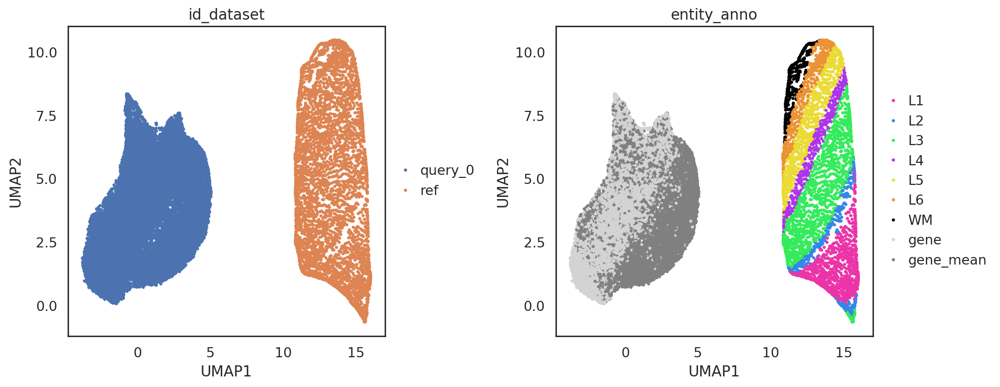

In [9]:
si.tl.umap(local_adata_all,n_neighbors=15,n_components=2)
si.pl.umap(local_adata_all[::-1,],color=['id_dataset','entity_anno'],
           dict_palette={'entity_anno': palette_entity_anno},
           drawing_order='original',
           fig_size=(6,5))

In [10]:
adata_fn = "/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/151507.h5ad"
adata_CG = sc.read_h5ad(adata_fn)

In [11]:
si.pp.select_variable_genes(adata_CG,layer='counts', n_top_genes=3000)
var_genes = adata_CG.var_names[adata_CG.var['highly_variable']].tolist()

3000 variable genes are selected.


In [12]:
var_genes_means = [f"{g}_mean_mean" for g in var_genes] # typo

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/simba/plotting/_plot.py:1065: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['color'] = dict()


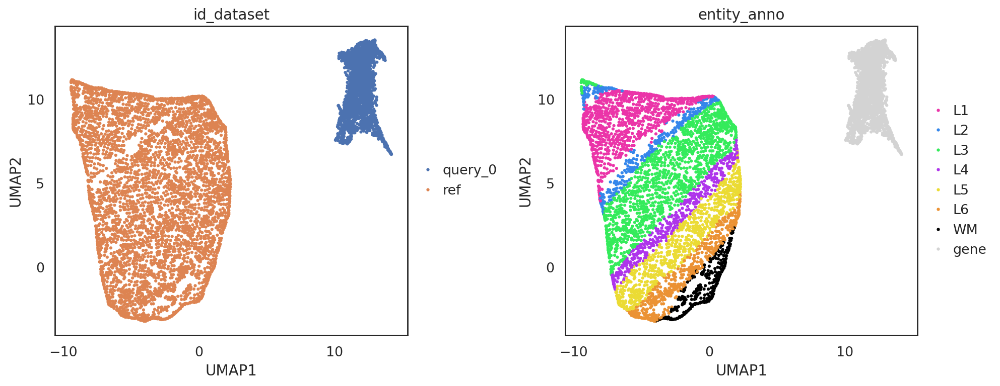

In [13]:
# obtain SIMBA embeddings of cells and variable genes
adata_all_var_genes = local_adata_all[list(local_adata_C.obs_names) + var_genes,].copy()
# visualize them using UMAP
si.tl.umap(adata_all_var_genes,n_neighbors=15,n_components=2)
si.pl.umap(adata_all_var_genes[::-1,], color=['id_dataset','entity_anno'],
           dict_palette={'entity_anno': palette_entity_anno},
           drawing_order='original',
           fig_size=(6,5))

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/simba/plotting/_plot.py:1065: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['color'] = dict()


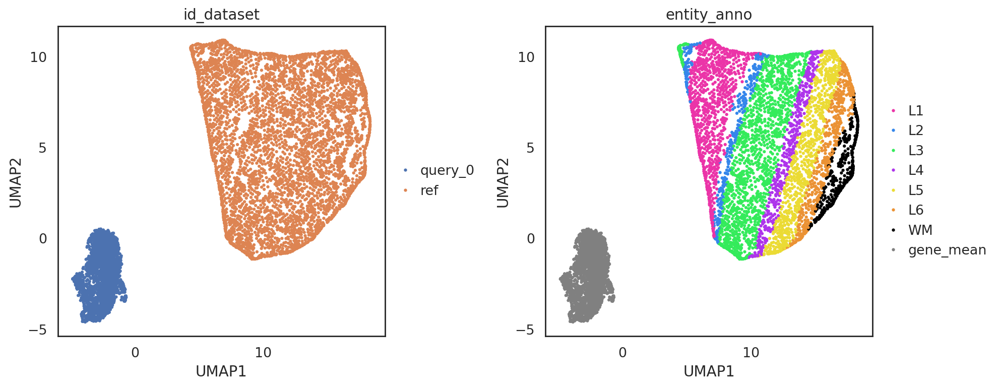

In [14]:
# obtain SIMBA embeddings of cells and variable genes
adata_all_var_genes_means = local_adata_all[list(local_adata_C.obs_names) + var_genes_means,].copy()
# visualize them using UMAP
si.tl.umap(adata_all_var_genes_means,n_neighbors=15,n_components=2)
si.pl.umap(adata_all_var_genes_means[::-1,], color=['id_dataset','entity_anno'],
           dict_palette={'entity_anno': palette_entity_anno},
           drawing_order='original',
           fig_size=(6,5))

## Cosine similarity between gene and gene_mean

In [15]:
G_obs_df = local_adata_G.obs.copy()

In [16]:
origG_obs_df = G_obs_df.query("gene_type == 'gene'").copy().sort_values(by='original_gene')
nbrG_obs_df = G_obs_df.query("gene_type == 'gene_mean'").copy().sort_values(by='original_gene')

In [17]:
orig_embed = local_adata_G[origG_obs_df.index].X
nbr_embed = local_adata_G[nbrG_obs_df.index].X
cosine_sim = np.sum(orig_embed*nbr_embed, axis=1)/(np.linalg.norm(orig_embed, axis=1)*np.linalg.norm(nbr_embed, axis=1))

In [18]:
cosine_sim_df = pd.DataFrame(index=origG_obs_df.index, data={'cosine_sim': cosine_sim})

In [19]:
mean_gene = adata_CG[:, cosine_sim_df.index].X.mean(axis=0)

Text(0, 0.5, 'mean expression')

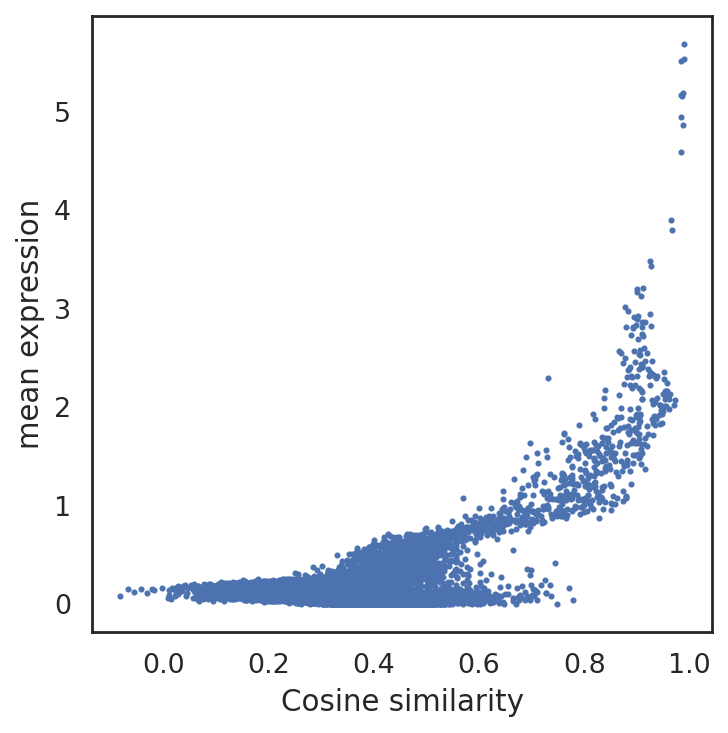

In [20]:
plt.scatter(
    x=cosine_sim_df['cosine_sim'].to_numpy(), y=np.asarray(mean_gene)[0], s=3
)
plt.xlabel('Cosine similarity')
plt.ylabel('mean expression')

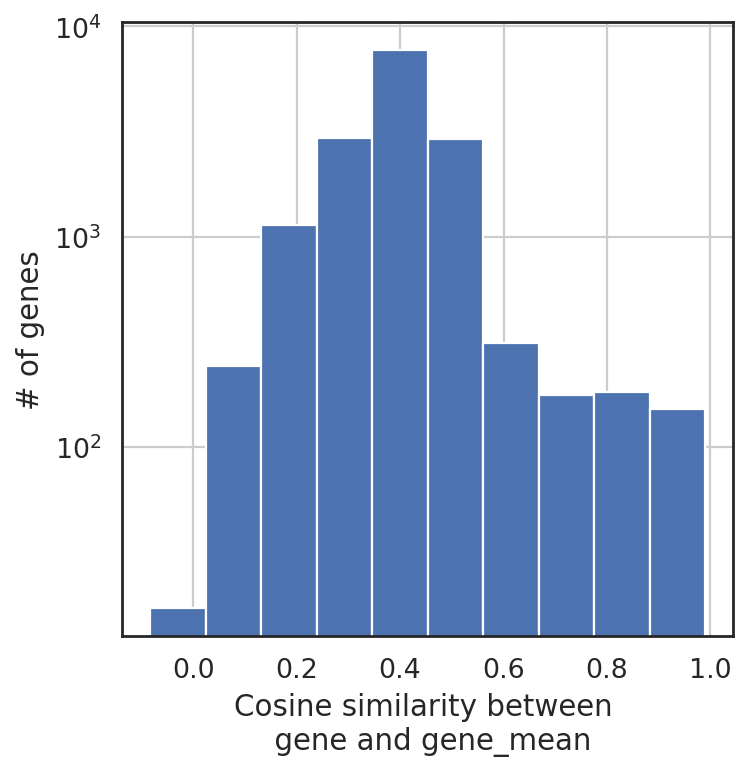

In [21]:
cosine_sim_df['cosine_sim'].hist()
plt.xlabel("Cosine similarity between \n gene and gene_mean")
plt.ylabel("# of genes")
plt.tight_layout()
plt.yscale("log")
plt.show()

In [22]:
# gene x gene_mean cosine similarity?
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns

In [29]:
similarities = cosine_similarity(local_adata_G[var_genes + var_genes_means].X)

In [30]:
similarities.shape

(6000, 6000)

In [34]:
local_adata_G[var_genes + var_genes_means].obs['gene_type']

AL390719.2                   gene
LRRC47                       gene
C1orf174                     gene
AL031847.1                   gene
ACOT7                        gene
                          ...    
MT-CO1_mean_mean        gene_mean
MT-CO2_mean_mean        gene_mean
MT-CO3_mean_mean        gene_mean
AC145212.1_mean_mean    gene_mean
AL592183.1_mean_mean    gene_mean
Name: gene_type, Length: 6000, dtype: object

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


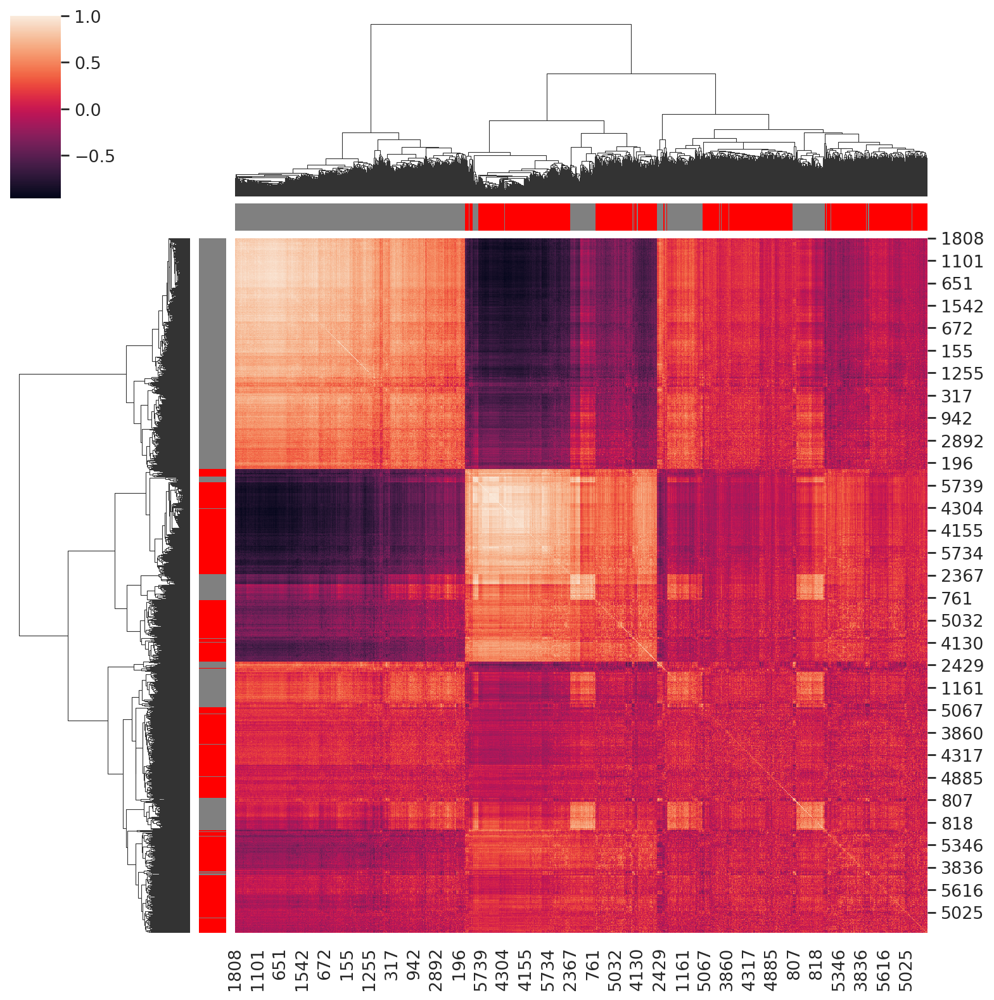

In [38]:
axis_colors = local_adata_G[var_genes + var_genes_means].obs['gene_type'].replace({'gene': 'gray', 'gene_mean': 'red'}).to_numpy()
sns.clustermap(similarities, row_colors=axis_colors, col_colors=axis_colors)

In [46]:
gene_vs_mean_similarities = cosine_similarity(local_adata_G[var_genes].X, local_adata_G[var_genes_means].X)

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


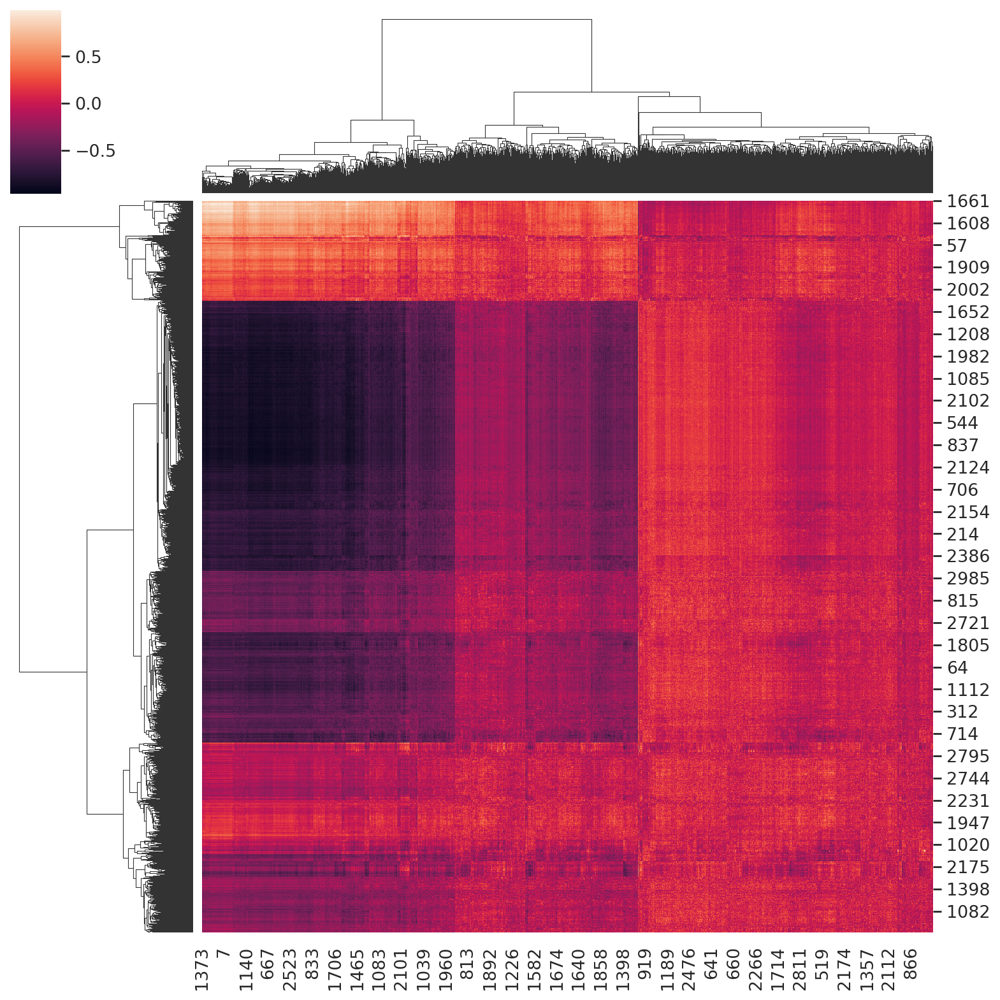

In [47]:
sns.clustermap(gene_vs_mean_similarities) # x: genes, y: gene_means

In [42]:
gene_vs_gene_similarities = cosine_similarity(local_adata_G[var_genes].X, local_adata_G[var_genes].X)

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


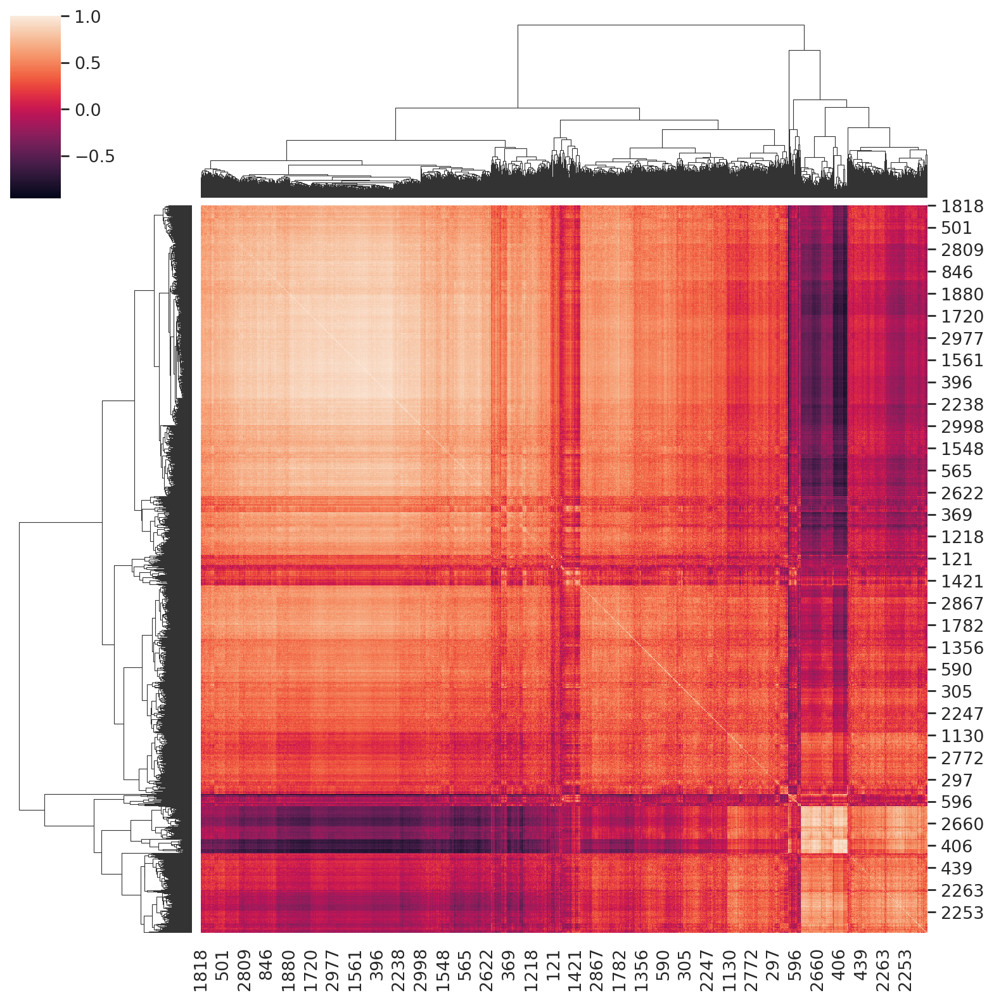

In [43]:
sns.clustermap(gene_vs_gene_similarities) # x: genes, y: gene

In [44]:
mean_vs_mean_similarities = cosine_similarity(local_adata_G[var_genes_means].X, local_adata_G[var_genes_means].X)

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


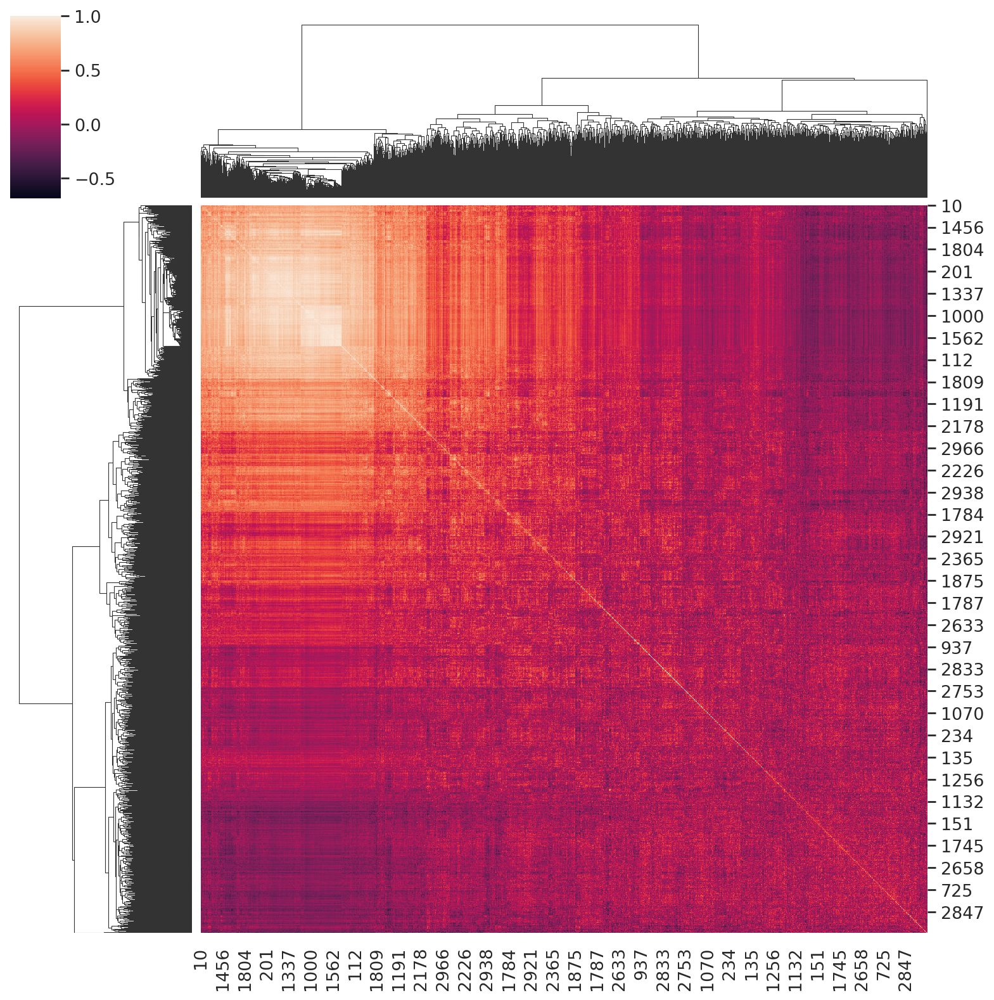

In [45]:
sns.clustermap(mean_vs_mean_similarities) # x: mean, y: gene_means

## Spatially variable

In [49]:
import squidpy as sq

In [50]:
sq.gr.spatial_neighbors(adata_CG, 
                        spatial_key="spatial",
                        coord_type="grid", 
                        delaunay=True)

sq.gr.spatial_autocorr(adata_CG, mode="moran", 
                       n_perms=100, n_jobs=10, 
                       genes=adata_CG.var_names)

100%|██████████| 100/100 [00:26<00:00,  3.81/s]


In [51]:
moranI_df = adata_CG.uns['moranI'].copy()

In [56]:
spatial_var_genes = moranI_df[moranI_df['pval_z_sim'] < 0.01].index.tolist()
spatial_var_genes_means = [f"{g}_mean_mean" for g in spatial_var_genes] # typo

In [57]:
spatial_gene_vs_mean_similarities = cosine_similarity(local_adata_G[spatial_var_genes].X, local_adata_G[spatial_var_genes_means].X)

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_mamba_simba/lib/python3.9/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


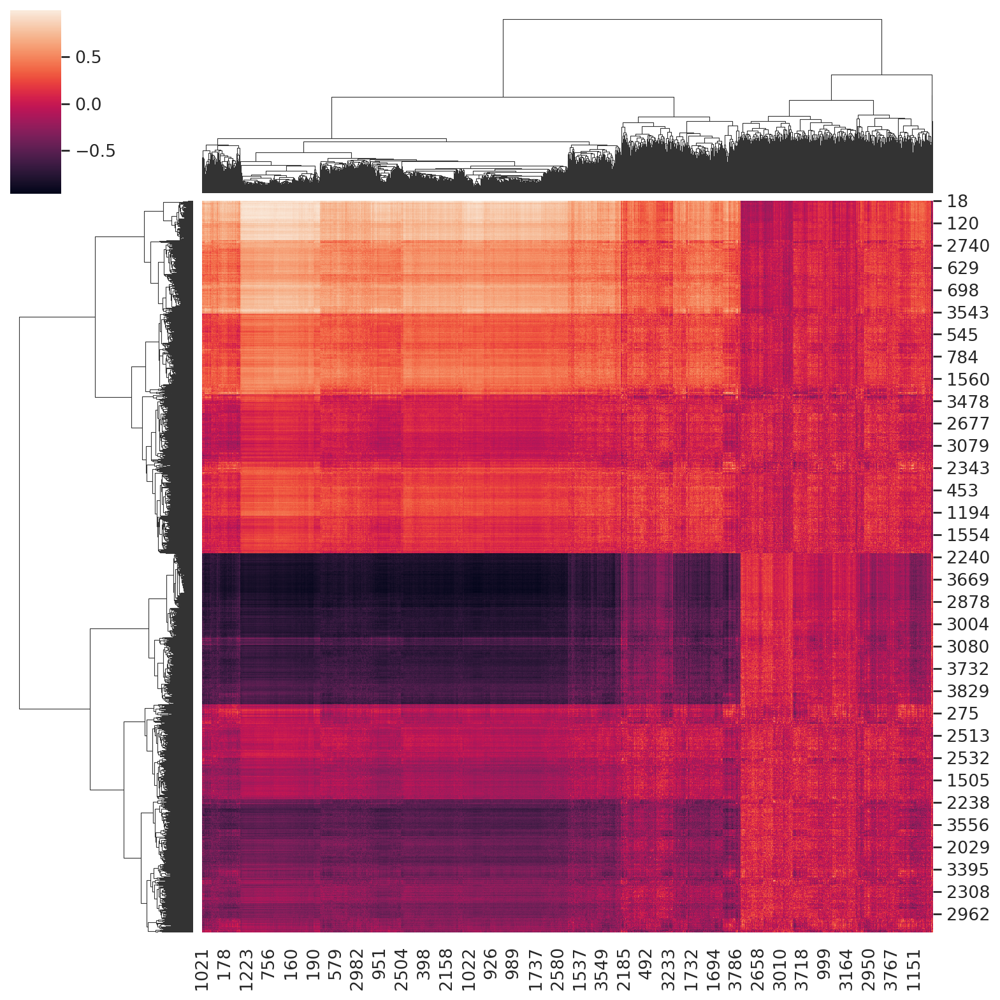

In [58]:
sns.clustermap(spatial_gene_vs_mean_similarities) # x: genes, y: gene

In [ ]:
spatial_gene_vs_gene_similarities = cosine_similarity(local_adata_G[spatial_var_genes].X, local_adata_G[spatial_var_genes].X)